In [1]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
##from pandas.plotting import parallel_coordinates
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
import seaborn as sns
from sklearn import tree
##plt.style.use("seaborn-dark")
plt.style.use('seaborn-v0_8-dark')

In [2]:
df = pd.read_csv('weatherAUS.csv')

In [3]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


<h3> Cantidad de lugares distintos de la base de datos </h3>

In [4]:
len(df['Location'].unique())

49

<h4> Hacemos una copia del la base de datos para cambiar los valores de 'yes' y 'no' por valores booleanos en la copia del DF </h4>

In [5]:
data = df.copy()

In [6]:
data['RainToday'] = (data['RainToday'] == 'Yes')*1
data['RainTomorrow'] = (data['RainTomorrow'] == 'Yes')*1

<h4>Cambiamos las abreviaciones de las direcciones del viento en las respectivas columnas </h4>

In [7]:
data.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [8]:
print(data.WindGustDir.unique())
print(data.WindDir9am.unique())
print(data.WindDir3pm.unique())

['W' 'WNW' 'WSW' 'NE' 'NNW' 'N' 'NNE' 'SW' nan 'ENE' 'SSE' 'S' 'NW' 'SE'
 'ESE' 'E' 'SSW']
['W' 'NNW' 'SE' 'ENE' 'SW' 'SSE' 'S' 'NE' nan 'SSW' 'N' 'WSW' 'ESE' 'E'
 'NW' 'WNW' 'NNE']
['WNW' 'WSW' 'E' 'NW' 'W' 'SSE' 'ESE' 'ENE' 'NNW' 'SSW' 'SW' 'SE' 'N' 'S'
 'NNE' nan 'NE']


In [9]:
Ab_WD = ['N','NNE','NE','ENE','E','ESE','SE','SSE','S', 'SSW','SW','WSW','W','WNW','NW','NNW']
WD = [0,22.5,45,67.5,90,112.5,135,157.5,180,202.5,225,247.5,270,292.5,315,337.5]
Col_WindDir = ['WindGustDir','WindDir9am','WindDir3pm']

In [10]:
#Dataframe de mapeo
Wind_Dir = pd.DataFrame({
    'Ab_WD': Ab_WD,
    'WD': WD
    })

#convertir a diccionario
wind_dir_map = dict(zip(Wind_Dir['Ab_WD'], Wind_Dir['WD']))
wind_dir_map

{'N': 0.0,
 'NNE': 22.5,
 'NE': 45.0,
 'ENE': 67.5,
 'E': 90.0,
 'ESE': 112.5,
 'SE': 135.0,
 'SSE': 157.5,
 'S': 180.0,
 'SSW': 202.5,
 'SW': 225.0,
 'WSW': 247.5,
 'W': 270.0,
 'WNW': 292.5,
 'NW': 315.0,
 'NNW': 337.5}

In [11]:
for column in Col_WindDir:
    data[column] = data[column].map(wind_dir_map)

<h4> Ahora veamos la cantidad de valores nulos que hay en la base de datos</h4>

<h4>Cantidad de valores nulos </h4>

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  float64
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  float64
 10  WindDir3pm     141232 non-null  float64
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [13]:
data.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday            0
RainTomorrow         0
dtype: int64

<h4>Calculemos los coeficientes de correlación de la base de datos para darnos una idea de que columnas pueden ser de utilidad y cuales no. </h4>

In [14]:
corr_data = data.select_dtypes(include=[float, int]).corr()
corr_data

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
MinTemp,1.000000,0.736555,0.103938,0.466993,0.072586,-0.176323,0.177415,-0.101278,-0.180212,0.175064,...,-0.232899,0.006089,-0.450970,-0.461292,0.078754,0.021605,0.901821,0.708906,0.054702,0.082455
MaxTemp,0.736555,1.000000,-0.074992,0.587932,0.470156,-0.189961,0.067615,-0.241169,-0.151406,0.014450,...,-0.504110,-0.508855,-0.332061,-0.427167,-0.289370,-0.277921,0.887210,0.984503,-0.226001,-0.157141
Rainfall,0.103938,-0.074992,1.000000,-0.064351,-0.227549,0.035316,0.133659,0.068652,0.034060,0.087338,...,0.224405,0.255755,-0.168154,-0.126534,0.198528,0.172403,0.011192,-0.079657,0.501516,0.236461
Evaporation,0.466993,0.587932,-0.064351,1.000000,0.365602,-0.097017,0.203021,-0.124446,-0.067127,0.193084,...,-0.504092,-0.390243,-0.270362,-0.293581,-0.183793,-0.182618,0.545115,0.572893,-0.185197,-0.117719
Sunshine,0.072586,0.470156,-0.227549,0.365602,1.000000,-0.070306,-0.034750,-0.082111,-0.039864,0.005499,...,-0.490819,-0.629130,0.041970,-0.019719,-0.675323,-0.703930,0.291188,0.490501,-0.324613,-0.443561
WindGustDir,-0.176323,-0.189961,0.035316,-0.097017,-0.070306,1.000000,0.144440,0.355927,0.564141,-0.000750,...,0.055518,0.014615,-0.164097,-0.097898,0.072232,0.074368,-0.195585,-0.199750,0.109109,0.059817
WindGustSpeed,0.177415,0.067615,0.133659,0.203021,-0.034750,0.144440,1.000000,0.044181,0.138491,0.605303,...,-0.215070,-0.026327,-0.458744,-0.413749,0.071736,0.109168,0.150150,0.032748,0.151605,0.229195
WindDir9am,-0.101278,-0.241169,0.068652,-0.124446,-0.082111,0.355927,0.044181,1.000000,0.261895,-0.007367,...,0.136257,0.156166,-0.064724,0.013762,0.077716,0.051256,-0.172810,-0.251392,0.146068,0.037027
WindDir3pm,-0.180212,-0.151406,0.034060,-0.067127,-0.039864,0.564141,0.138491,0.261895,1.000000,0.016410,...,0.025388,-0.048623,-0.166488,-0.101580,0.041971,0.058699,-0.183184,-0.156264,0.095618,0.045575
WindSpeed9am,0.175064,0.014450,0.087338,0.193084,0.005499,-0.000750,0.605303,-0.007367,0.016410,1.000000,...,-0.270858,-0.031614,-0.228743,-0.175817,0.025112,0.054639,0.128545,0.004569,0.099084,0.087145


<h4> Visualicemos esto con un gráfico </h4>

<Axes: >

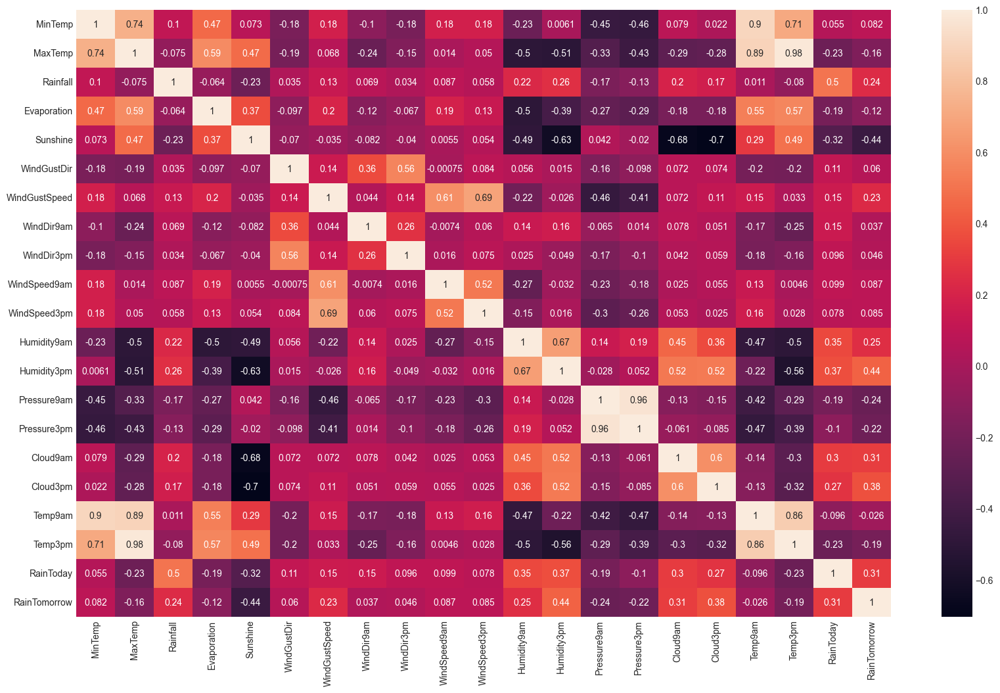

In [15]:
plt.figure(figsize=(20,12))
sns.heatmap(corr_data,annot=True)

<h4>Cantidad de valores nulos en porcentaje </h4>

In [16]:
(data.isnull().sum()*100)/len(data.index)

Date              0.000000
Location          0.000000
MinTemp           1.020899
MaxTemp           0.866905
Rainfall          2.241853
Evaporation      43.166506
Sunshine         48.009762
WindGustDir       7.098859
WindGustSpeed     7.055548
WindDir9am        7.263853
WindDir3pm        2.906641
WindSpeed9am      1.214767
WindSpeed3pm      2.105046
Humidity9am       1.824557
Humidity3pm       3.098446
Pressure9am      10.356799
Pressure3pm      10.331363
Cloud9am         38.421559
Cloud3pm         40.807095
Temp9am           1.214767
Temp3pm           2.481094
RainToday         0.000000
RainTomorrow      0.000000
dtype: float64

<h4>Dado que queremos un modelo que prediga si lloverá o no en una o varias de las ciudades de la base de datos, lo que haremos será optar por predecir con un modelo de árbol de desiciones (clasificador) </h4>

<h4>Puesto que queremos predecir especificamente en cada ciudad, como primer acercamiento separaremos los datos de cada ciudad en la base de datos y la limpiaremos para proceder a crear el modelo. </h4>

Para esto creamos un diccionario que contenga las bases de datos de cada lugar


In [17]:
Loc = data['Location'].unique()
df_dict_Loc = {city: data[data['Location'] == city] for city in Loc}

In [18]:
df_dict_Loc

{'Albury':             Date Location  MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine  \
 0     2008-12-01   Albury     13.4     22.9       0.6          NaN       NaN   
 1     2008-12-02   Albury      7.4     25.1       0.0          NaN       NaN   
 2     2008-12-03   Albury     12.9     25.7       0.0          NaN       NaN   
 3     2008-12-04   Albury      9.2     28.0       0.0          NaN       NaN   
 4     2008-12-05   Albury     17.5     32.3       1.0          NaN       NaN   
 ...          ...      ...      ...      ...       ...          ...       ...   
 3035  2017-06-21   Albury      1.2     15.2       0.4          NaN       NaN   
 3036  2017-06-22   Albury      0.8     13.4       0.0          NaN       NaN   
 3037  2017-06-23   Albury      1.1     11.9       0.0          NaN       NaN   
 3038  2017-06-24   Albury      1.1     14.1       0.2          NaN       NaN   
 3039  2017-06-25   Albury      3.9     10.9       0.0          NaN       NaN   
 
       WindGustD

Ahora procedemos a limpiar cada base de datos. 

Lo primero sera ver cuantos (porcentaje) valores nulos hay en cada base de datos.

In [19]:
null_val_perc = {}
for city, df_city in df_dict_Loc.items():
    null_val_perc[city] = (df_city.isnull().sum()*100) / len(df_city)

In [20]:
null_val_perc

{'Albury': Date               0.000000
 Location           0.000000
 MinTemp            0.361842
 MaxTemp            0.361842
 Rainfall           0.953947
 Evaporation      100.000000
 Sunshine         100.000000
 WindGustDir        1.052632
 WindGustSpeed      1.052632
 WindDir9am        17.269737
 WindDir3pm         1.513158
 WindSpeed9am       0.296053
 WindSpeed3pm       0.361842
 Humidity9am        0.296053
 Humidity3pm        0.263158
 Pressure9am        0.164474
 Pressure3pm        0.263158
 Cloud9am          57.598684
 Cloud3pm          53.059211
 Temp9am            0.296053
 Temp3pm            0.263158
 RainToday          0.000000
 RainTomorrow       0.000000
 dtype: float64,
 'BadgerysCreek': Date               0.000000
 Location           0.000000
 MinTemp            1.196411
 MaxTemp            0.963775
 Rainfall           2.691924
 Evaporation      100.000000
 Sunshine         100.000000
 WindGustDir        2.525756
 WindGustSpeed      2.525756
 WindDir9am        14.456630

Veamos las columnas con mas valores nulos y borremos las columnas que tengan todos sus valores nulos

In [21]:
for city in list(df_dict_Loc.keys()):
    cols_to_drop = null_val_perc[city][null_val_perc[city] == 100.0].index
    df_dict_Loc[city].drop(columns=cols_to_drop, axis=1, inplace=True)
    null_val_perc[city].drop(labels=cols_to_drop, inplace=True)

C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\3295363334.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dict_Loc[city].drop(columns=cols_to_drop, axis=1, inplace=True)


In [22]:
for city in df_dict_Loc.keys():
    print(f"DB for {city}")
    print(f"Porcentaje de valores nulos después eliminar columnas:\n{null_val_perc[city]}")
    print("="*50)

DB for Albury
Porcentaje de valores nulos después eliminar columnas:
Date              0.000000
Location          0.000000
MinTemp           0.361842
MaxTemp           0.361842
Rainfall          0.953947
WindGustDir       1.052632
WindGustSpeed     1.052632
WindDir9am       17.269737
WindDir3pm        1.513158
WindSpeed9am      0.296053
WindSpeed3pm      0.361842
Humidity9am       0.296053
Humidity3pm       0.263158
Pressure9am       0.164474
Pressure3pm       0.263158
Cloud9am         57.598684
Cloud3pm         53.059211
Temp9am           0.296053
Temp3pm           0.263158
RainToday         0.000000
RainTomorrow      0.000000
dtype: float64
DB for BadgerysCreek
Porcentaje de valores nulos después eliminar columnas:
Date              0.000000
Location          0.000000
MinTemp           1.196411
MaxTemp           0.963775
Rainfall          2.691924
WindGustDir       2.525756
WindGustSpeed     2.525756
WindDir9am       14.456630
WindDir3pm        2.824859
WindSpeed9am      1.628448
Win

In [24]:
df_dict_Loc

{'Albury':             Date Location  MinTemp  MaxTemp  Rainfall  WindGustDir  \
 0     2008-12-01   Albury     13.4     22.9       0.6        270.0   
 1     2008-12-02   Albury      7.4     25.1       0.0        292.5   
 2     2008-12-03   Albury     12.9     25.7       0.0        247.5   
 3     2008-12-04   Albury      9.2     28.0       0.0         45.0   
 4     2008-12-05   Albury     17.5     32.3       1.0        270.0   
 ...          ...      ...      ...      ...       ...          ...   
 3035  2017-06-21   Albury      1.2     15.2       0.4         67.5   
 3036  2017-06-22   Albury      0.8     13.4       0.0        270.0   
 3037  2017-06-23   Albury      1.1     11.9       0.0        135.0   
 3038  2017-06-24   Albury      1.1     14.1       0.2        247.5   
 3039  2017-06-25   Albury      3.9     10.9       0.0        337.5   
 
       WindGustSpeed  WindDir9am  WindDir3pm  WindSpeed9am  ...  Humidity9am  \
 0              44.0       270.0       292.5          20

In [25]:
null_val_perc

{'Albury': Date              0.000000
 Location          0.000000
 MinTemp           0.361842
 MaxTemp           0.361842
 Rainfall          0.953947
 WindGustDir       1.052632
 WindGustSpeed     1.052632
 WindDir9am       17.269737
 WindDir3pm        1.513158
 WindSpeed9am      0.296053
 WindSpeed3pm      0.361842
 Humidity9am       0.296053
 Humidity3pm       0.263158
 Pressure9am       0.164474
 Pressure3pm       0.263158
 Cloud9am         57.598684
 Cloud3pm         53.059211
 Temp9am           0.296053
 Temp3pm           0.263158
 RainToday         0.000000
 RainTomorrow      0.000000
 dtype: float64,
 'BadgerysCreek': Date              0.000000
 Location          0.000000
 MinTemp           1.196411
 MaxTemp           0.963775
 Rainfall          2.691924
 WindGustDir       2.525756
 WindGustSpeed     2.525756
 WindDir9am       14.456630
 WindDir3pm        2.824859
 WindSpeed9am      1.628448
 WindSpeed3pm      1.595214
 Humidity9am       1.794616
 Humidity3pm       1.827850
 Pre

Dado que todavia hay columnas con valores nulos, en esta ocasión optaremos por rellenar los valores con la media o moda dependiendo del tipo de datos.

Columnas que se rellenan con la moda.

In [26]:
Col_Mode =['WindGustDir','WindDir9am','WindDir3pm','Cloud9am','Cloud3pm']

for key, city in df_dict_Loc.items():
    for column in Col_Mode:
        if column in city.columns:
            mode_value = city[column].mode()[0]
            city[column].fillna(mode_value, inplace=True)

C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\4159744309.py:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  city[column].fillna(mode_value, inplace=True)
C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\4159744309.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city[column].fillna(mode_value, inplace=True)


Columnas que se rellenan con la media.

In [50]:
for city, df_city in df_dict_Loc.items():
    numeric_cols = df.select_dtypes(include='number').columns
    numeric_cols = [column for column in numeric_cols if column in df_city.columns]
    df_city[numeric_cols] = df_city[numeric_cols].fillna(df_city[numeric_cols].mean())


C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\554195962.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_city[numeric_cols] = df_city[numeric_cols].fillna(df_city[numeric_cols].mean())
C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\554195962.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_city[numeric_cols] = df_city[numeric_cols].fillna(df_city[numeric_cols].mean())
C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\554195962.py:4: SettingWithCopyWarning: 
A value is trying to be set on 

Ahora no hay base de datos con valores nulos. Corroboremos esto.

In [53]:
null_val_perc = {}
for city, df_city in df_dict_Loc.items():
    null_val_perc[city] = (df_city.isnull().sum()*100) / len(df_city)

In [54]:
null_val_perc

{'Albury': Date             0.0
 Location         0.0
 MinTemp          0.0
 MaxTemp          0.0
 Rainfall         0.0
 WindGustDir      0.0
 WindGustSpeed    0.0
 WindDir9am       0.0
 WindDir3pm       0.0
 WindSpeed9am     0.0
 WindSpeed3pm     0.0
 Humidity9am      0.0
 Humidity3pm      0.0
 Pressure9am      0.0
 Pressure3pm      0.0
 Cloud9am         0.0
 Cloud3pm         0.0
 Temp9am          0.0
 Temp3pm          0.0
 RainToday        0.0
 RainTomorrow     0.0
 dtype: float64,
 'BadgerysCreek': Date             0.0
 Location         0.0
 MinTemp          0.0
 MaxTemp          0.0
 Rainfall         0.0
 WindGustDir      0.0
 WindGustSpeed    0.0
 WindDir9am       0.0
 WindDir3pm       0.0
 WindSpeed9am     0.0
 WindSpeed3pm     0.0
 Humidity9am      0.0
 Humidity3pm      0.0
 Pressure9am      0.0
 Pressure3pm      0.0
 Temp9am          0.0
 Temp3pm          0.0
 RainToday        0.0
 RainTomorrow     0.0
 dtype: float64,
 'Cobar': Date             0.0
 Location         0.0
 MinTe

Ahora veamos los coeficientes de correlación y decidamos con cuales características qeudarnos 
para el modelo.

In [55]:
coef_corr = {elem : pd.DataFrame() for elem in Loc}
for city, df_city in df_dict_Loc.items():
    coef_corr[city]= df_dict_Loc[city].select_dtypes(include=[float, int]).corr()

In [56]:
coef_corr

{'Albury':                 MinTemp   MaxTemp  Rainfall  WindGustDir  WindGustSpeed  \
 MinTemp        1.000000  0.802514  0.122882    -0.010728       0.415321   
 MaxTemp        0.802514  1.000000 -0.117123    -0.068387       0.259818   
 Rainfall       0.122882 -0.117123  1.000000     0.078670       0.156247   
 WindGustDir   -0.010728 -0.068387  0.078670     1.000000       0.251696   
 WindGustSpeed  0.415321  0.259818  0.156247     0.251696       1.000000   
 WindDir9am    -0.046062 -0.206623  0.115685     0.259123       0.179216   
 WindDir3pm     0.004209 -0.053338  0.095944     0.515218       0.175515   
 WindSpeed9am   0.317085  0.063670  0.194560     0.115066       0.517376   
 WindSpeed3pm   0.249155  0.116617  0.121019     0.278699       0.682392   
 Humidity9am   -0.573405 -0.747025  0.214016    -0.006343      -0.335172   
 Humidity3pm   -0.380226 -0.753207  0.262547    -0.020460      -0.151016   
 Pressure9am   -0.577355 -0.329132 -0.274846    -0.237451      -0.605888   
 P

C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\2441891055.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20,12))


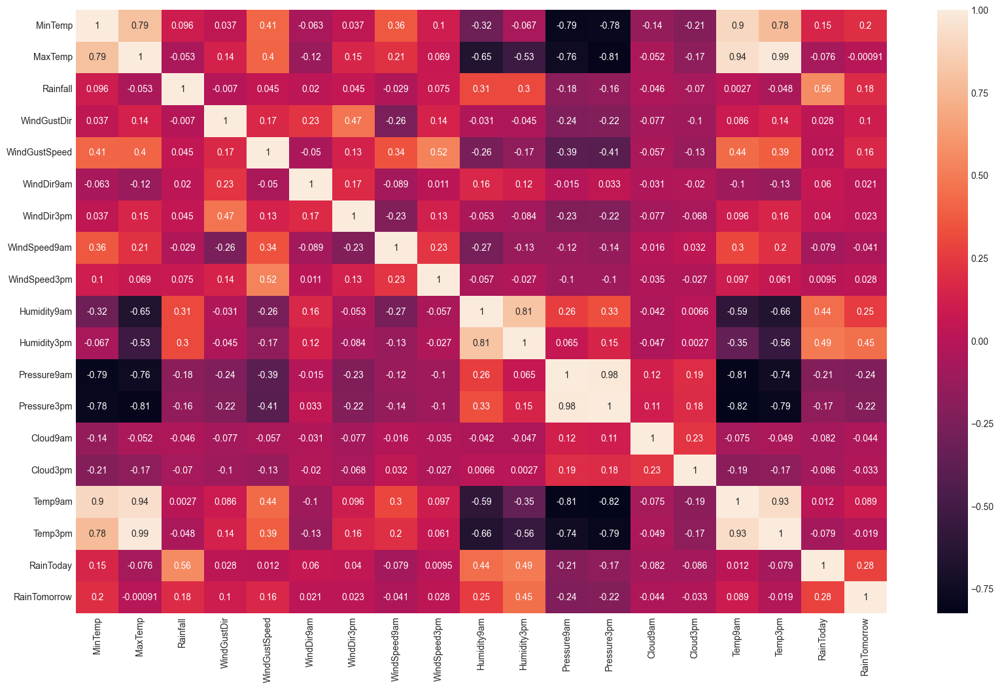

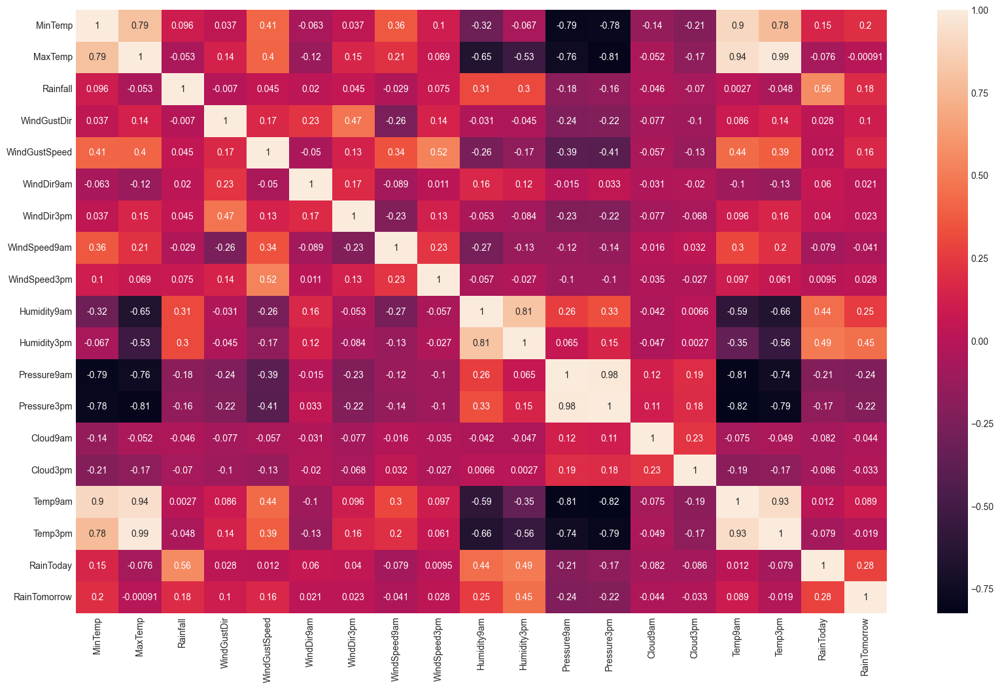

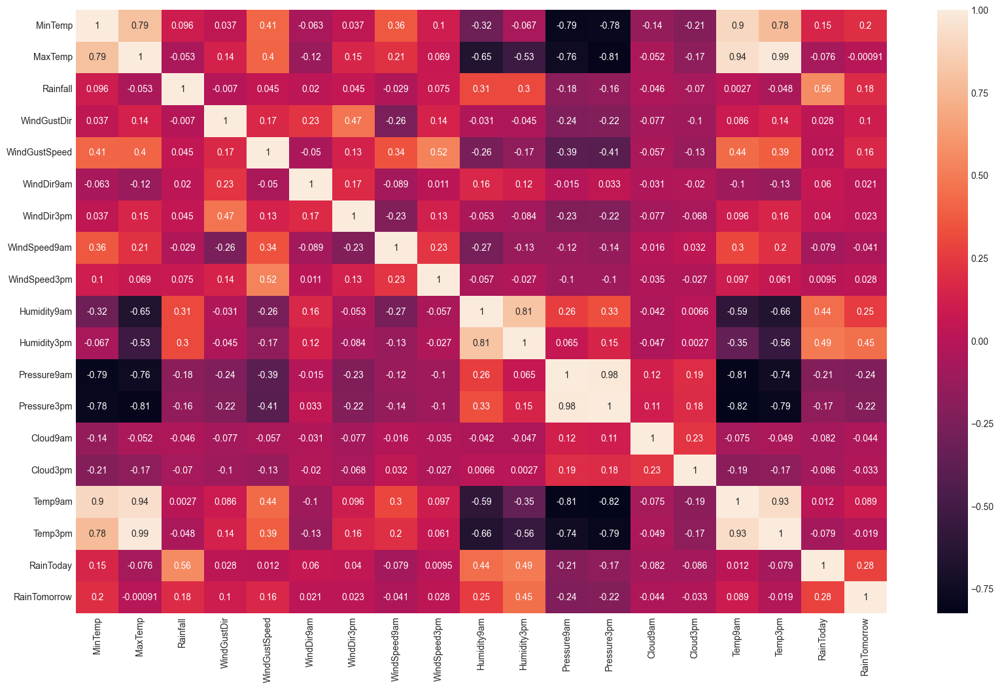

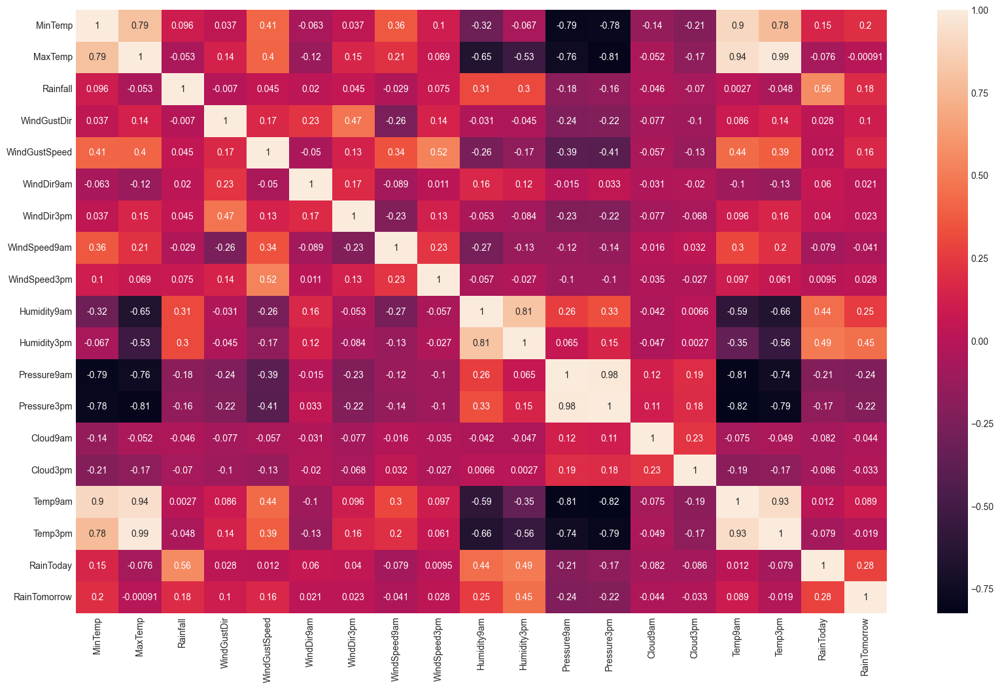

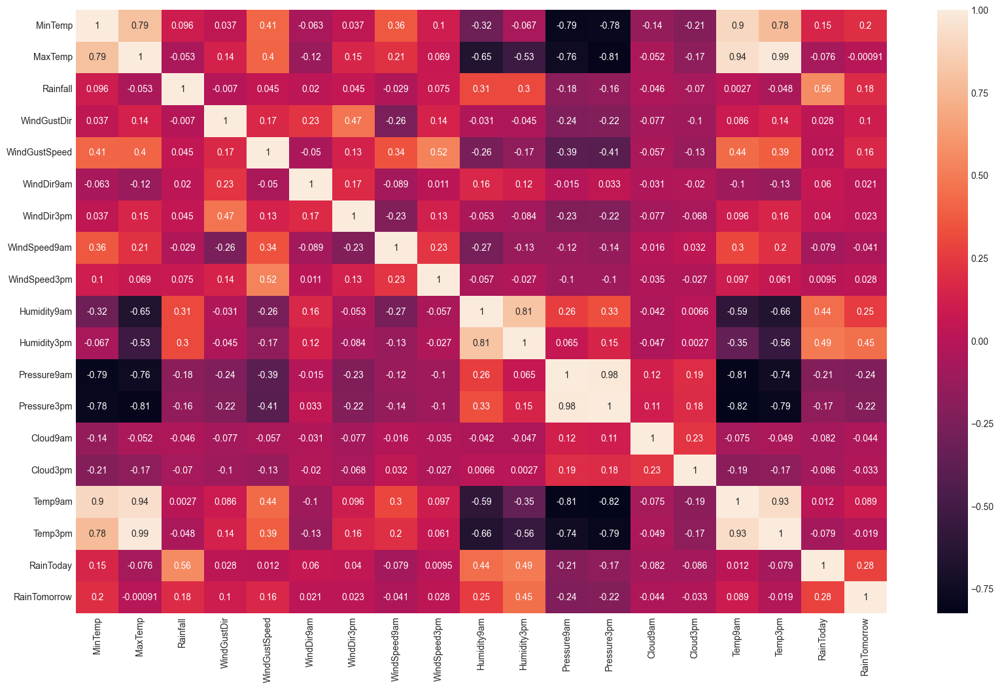

...

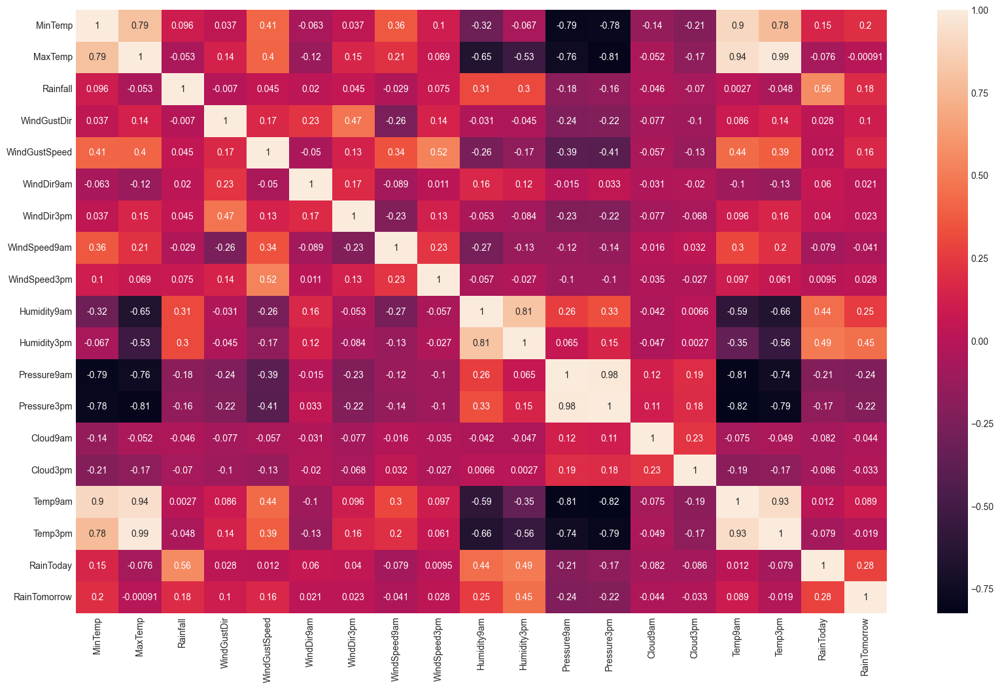

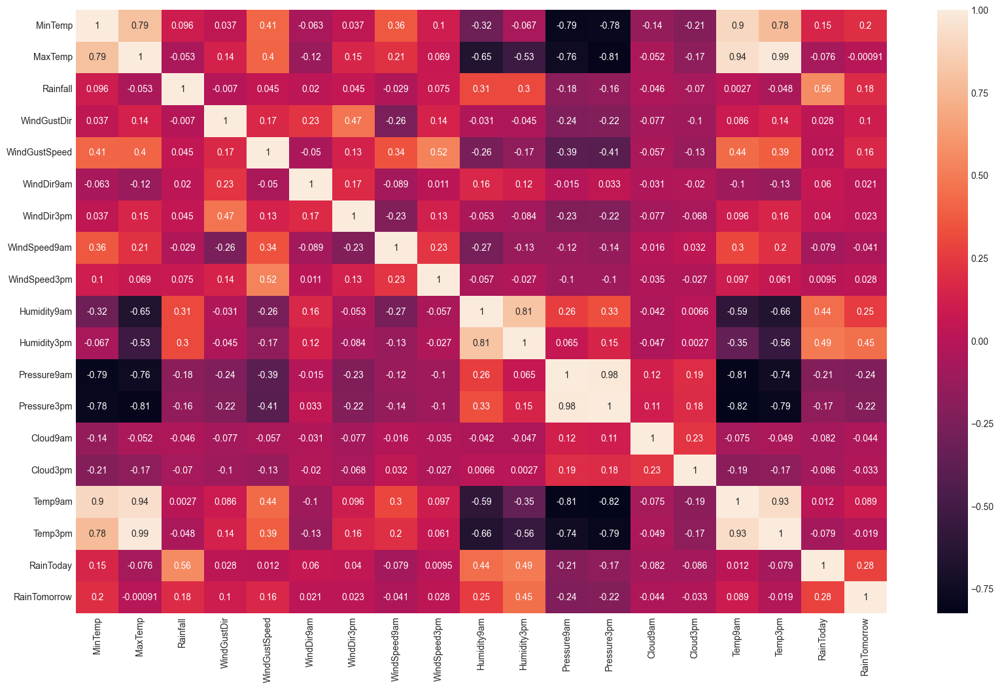

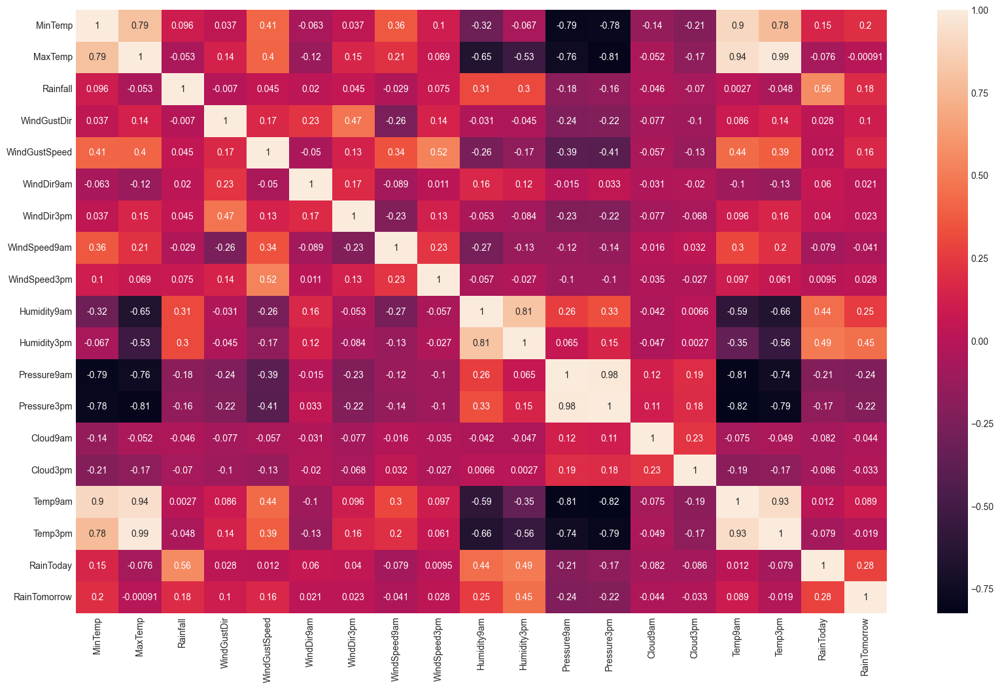

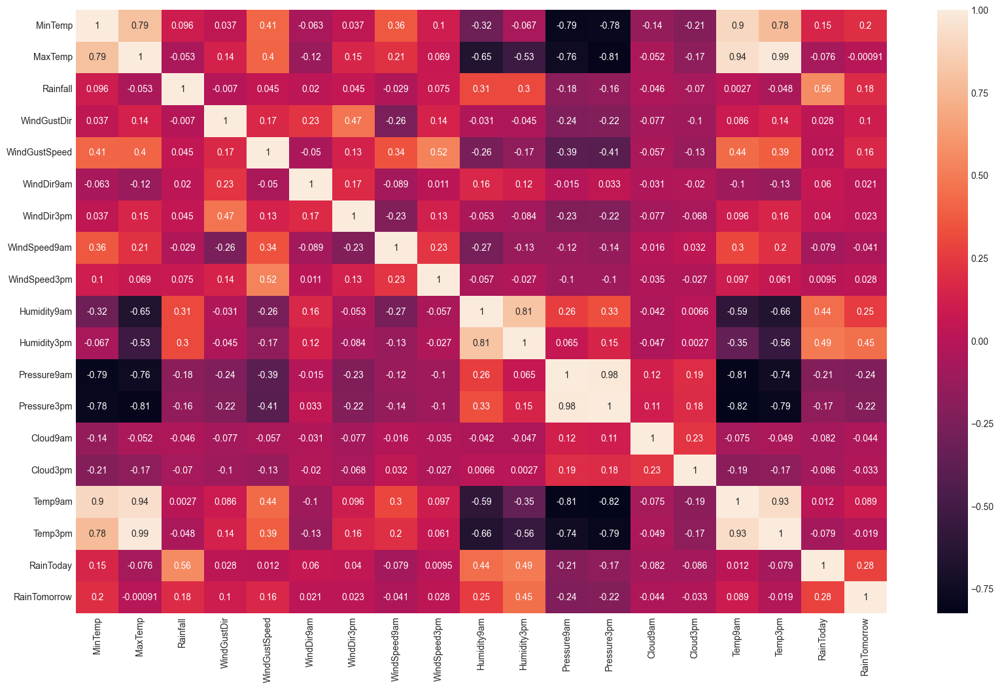

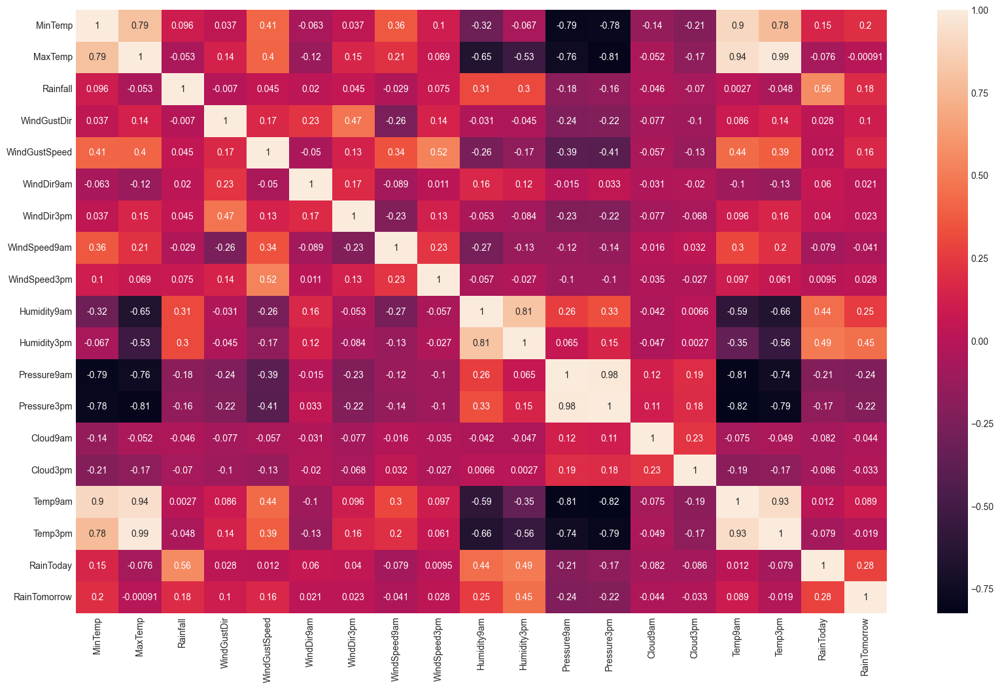

In [57]:
for keys in df_dict_Loc.keys():
    plt.figure(figsize=(20,12))
    sns.heatmap(coef_corr[key],annot=True)

Para el modelo elegiremos las columnas con coeficientes cuyos valores absolutos son
mayores o iguales a .1 

Coeficientes positivos

In [58]:
coef_corr_p = {elem : pd.DataFrame() for elem in Loc}
for key in df_dict_Loc.keys():
    coef_corr_p[key]= coef_corr[key][coef_corr[key]['RainTomorrow']>= .1]
    coef_corr_p[key]=coef_corr_p[key].drop(['RainTomorrow'],axis=0)

In [59]:
coef_corr_p

{'Albury':                 MinTemp   MaxTemp  Rainfall  WindGustDir  WindGustSpeed  \
 Rainfall       0.122882 -0.117123  1.000000     0.078670       0.156247   
 WindGustSpeed  0.415321  0.259818  0.156247     0.251696       1.000000   
 WindSpeed9am   0.317085  0.063670  0.194560     0.115066       0.517376   
 WindSpeed3pm   0.249155  0.116617  0.121019     0.278699       0.682392   
 Humidity9am   -0.573405 -0.747025  0.214016    -0.006343      -0.335172   
 Humidity3pm   -0.380226 -0.753207  0.262547    -0.020460      -0.151016   
 RainToday      0.063744 -0.257182  0.584108     0.117880       0.207938   
 
                WindDir9am  WindDir3pm  WindSpeed9am  WindSpeed3pm  \
 Rainfall         0.115685    0.095944      0.194560      0.121019   
 WindGustSpeed    0.179216    0.175515      0.517376      0.682392   
 WindSpeed9am     0.306693    0.130709      1.000000      0.441830   
 WindSpeed3pm     0.221408    0.257684      0.441830      1.000000   
 Humidity9am      0.059758   -

Coeficientes negativos

In [60]:
coef_corr_n = {elem : pd.DataFrame() for elem in df_dict_Loc.keys()}
for key in df_dict_Loc.keys():
    coef_corr_n[key]= coef_corr[key][coef_corr[key]['RainTomorrow']<= -.1]

In [61]:
coef_corr_n

{'Albury':               MinTemp   MaxTemp  Rainfall  WindGustDir  WindGustSpeed  \
 MaxTemp      0.802514  1.000000 -0.117123    -0.068387       0.259818   
 WindDir3pm   0.004209 -0.053338  0.095944     0.515218       0.175515   
 Pressure9am -0.577355 -0.329132 -0.274846    -0.237451      -0.605888   
 Pressure3pm -0.588941 -0.408332 -0.209989    -0.165689      -0.594820   
 Temp3pm      0.777523  0.990245 -0.125561    -0.076696       0.225875   
 
              WindDir9am  WindDir3pm  WindSpeed9am  WindSpeed3pm  Humidity9am  \
 MaxTemp       -0.206623   -0.053338      0.063670      0.116617    -0.747025   
 WindDir3pm     0.225183    1.000000      0.130709      0.257684    -0.020016   
 Pressure9am   -0.171885   -0.208181     -0.456690     -0.506513     0.300700   
 Pressure3pm   -0.069107   -0.127874     -0.384733     -0.466692     0.336972   
 Temp3pm       -0.212921   -0.057606      0.034180      0.098484    -0.732888   
 
              Humidity3pm  Pressure9am  Pressure3pm  Clo

Ahora tomemos esas características

In [62]:
total_len = {elem : list() for elem in Loc}
for key in df_dict_Loc.keys():
    total_len[key].append(len(coef_corr_p[key].index) +len(coef_corr_n[key].index))

In [63]:
total_len['Albury'][0]

12

In [64]:
features = {elem : list() for elem in Loc}
for key in df_dict_Loc.keys():
    for i in range(0,total_len[key][0]):
        if i<=(len(coef_corr_p[key])-1):
            features[key].append(coef_corr_p[key].index[i])
        elif i >= len(coef_corr_p[key]):
            features[key].append(coef_corr_n[key].index[i-(len(coef_corr_p[key])+1)])

In [65]:
features

{'Albury': ['Rainfall',
  'WindGustSpeed',
  'WindSpeed9am',
  'WindSpeed3pm',
  'Humidity9am',
  'Humidity3pm',
  'RainToday',
  'Temp3pm',
  'MaxTemp',
  'WindDir3pm',
  'Pressure9am',
  'Pressure3pm'],
 'BadgerysCreek': ['MinTemp',
  'Rainfall',
  'Humidity9am',
  'Humidity3pm',
  'RainToday',
  'Temp3pm'],
 'Cobar': ['MinTemp',
  'Rainfall',
  'WindGustSpeed',
  'Humidity9am',
  'Humidity3pm',
  'Cloud9am',
  'Cloud3pm',
  'RainToday',
  'Temp3pm',
  'Sunshine',
  'WindDir3pm',
  'Pressure9am',
  'Pressure3pm'],
 'CoffsHarbour': ['MinTemp',
  'Rainfall',
  'WindGustSpeed',
  'WindDir3pm',
  'WindSpeed9am',
  'Humidity9am',
  'Humidity3pm',
  'Cloud9am',
  'Cloud3pm',
  'RainToday',
  'Temp3pm',
  'Sunshine'],
 'Moree': ['MinTemp',
  'Rainfall',
  'WindGustSpeed',
  'WindSpeed9am',
  'Humidity9am',
  'Humidity3pm',
  'Cloud9am',
  'Cloud3pm',
  'RainToday',
  'Temp3pm',
  'Sunshine',
  'WindDir3pm',
  'Pressure9am',
  'Pressure3pm'],
 'Newcastle': ['Rainfall',
  'Humidity9am',
  'Hu

Pasemos a crear los modelos

In [66]:
X = {elem : pd.DataFrame() for elem in Loc}
for key in df_dict_Loc.keys():
    X[key]= df_dict_Loc[key][features[key]].copy()

In [67]:
X

{'Albury':       Rainfall  WindGustSpeed  WindSpeed9am  WindSpeed3pm  Humidity9am  \
 0          0.6           44.0          20.0          24.0         71.0   
 1          0.0           44.0           4.0          22.0         44.0   
 2          0.0           46.0          19.0          26.0         38.0   
 3          0.0           24.0          11.0           9.0         45.0   
 4          1.0           41.0           7.0          20.0         82.0   
 ...        ...            ...           ...           ...          ...   
 3035       0.4           15.0           0.0           2.0        100.0   
 3036       0.0           17.0           6.0           0.0        100.0   
 3037       0.0           44.0           9.0           2.0        100.0   
 3038       0.2           28.0           4.0          15.0        100.0   
 3039       0.0           28.0           6.0           0.0         88.0   
 
       Humidity3pm  RainToday  Temp3pm  MaxTemp  WindDir3pm  Pressure9am  \
 0          

In [68]:
y = {elem : pd.DataFrame() for elem in Loc}
for key in df_dict_Loc.keys():
    y[key]= df_dict_Loc[key][['RainTomorrow']].copy()

In [69]:
y

{'Albury':       RainTomorrow
 0                0
 1                0
 2                0
 3                0
 4                0
 ...            ...
 3035             0
 3036             0
 3037             0
 3038             0
 3039             1
 
 [3040 rows x 1 columns],
 'BadgerysCreek':       RainTomorrow
 3040             0
 3041             0
 3042             0
 3043             0
 3044             0
 ...            ...
 6044             0
 6045             0
 6046             0
 6047             0
 6048             0
 
 [3009 rows x 1 columns],
 'Cobar':       RainTomorrow
 6049             0
 6050             0
 6051             0
 6052             0
 6053             0
 ...            ...
 9053             0
 9054             0
 9055             0
 9056             0
 9057             0
 
 [3009 rows x 1 columns],
 'CoffsHarbour':        RainTomorrow
 9058              0
 9059              1
 9060              0
 9061              0
 9062              0
 ...             .

Ya tenemos todo para hacer el modelo, podemos elegir cualquier "llave " del
diccionario y ver que tan bueno es el modelo

In [70]:
key='Canberra'
X_train, X_test, y_train, y_test = train_test_split(X[key], y[key], test_size=0.33, random_state=324)

In [71]:
val_met=pd.DataFrame(columns=['node','accuracy'],index=range(22))
for i in range(3,25):
    Rain_Tomorrow = DecisionTreeClassifier(max_leaf_nodes=i, random_state=0)
    Rain_Tomorrow.fit(X_train, y_train)
    predictions = Rain_Tomorrow.predict(X_test)
    j=i-3
    val_met.iloc[j][0] = i 
    val_met.iloc[j][1]=(accuracy_score(y_true = y_test, y_pred = predictions))
    print(i,' ',accuracy_score(y_true = y_test, y_pred = predictions))

C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\3973891521.py:7: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  val_met.iloc[j][0] = i
C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\3973891521.py:7: FutureWarning: Series.__setitem__ trea

3   0.8641975308641975
4   0.8641975308641975
5   0.8641975308641975
6   0.8641975308641975
7   0.8650793650793651
8   0.86331569664903
9   0.8615520282186949
10   0.86331569664903
11   0.8650793650793651
12   0.8659611992945326
13   0.8659611992945326
14   0.8677248677248677
15   0.8677248677248677
16   0.8677248677248677
17   0.8677248677248677
18   0.8668430335097002
19   0.8659611992945326
20   0.8659611992945326
21   0.8659611992945326
22   0.8641975308641975
23   0.8615520282186949
24   0.8624338624338624


C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\3973891521.py:7: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  val_met.iloc[j][0] = i
C:\Users\jcarl\AppData\Local\Temp\ipykernel_10460\3973891521.py:7: FutureWarning: Series.__setitem__ trea

In [72]:
val_met

,node,accuracy
0,3,0.864198
1,4,0.864198
2,5,0.864198
3,6,0.864198
4,7,0.865079
5,8,0.863316
6,9,0.861552
7,10,0.863316
8,11,0.865079
9,12,0.865961
